In [1]:
%%capture
# Install facenet-pytorch
!pip install /kaggle/input/facenet-pytorch-vggface2/facenet_pytorch-1.0.1-py3-none-any.whl

# Copy model checkpoints to torch cache so they are loaded automatically by the package
!mkdir -p /tmp/.cache/torch/checkpoints/
!cp /kaggle/input/facenet-pytorch-vggface2/20180402-114759-vggface2-logits.pth /tmp/.cache/torch/checkpoints/vggface2_DG3kwML46X.pt
!cp /kaggle/input/facenet-pytorch-vggface2/20180402-114759-vggface2-features.pth /tmp/.cache/torch/checkpoints/vggface2_G5aNV2VSMn.pt

In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from pathlib import Path
from facenet_pytorch import MTCNN
import torch
import torch.nn as nn
import torch.nn.functional as F
import cv2
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
from PIL import Image
from tqdm.notebook import tqdm
from time import time
import shutil

import warnings
warnings.filterwarnings("ignore")

# https://www.kaggle.com/hmendonca/kaggle-pytorch-utility-script
from kaggle_pytorch_utility_script import *

seed_everything(42)

In [3]:
# See github.com/timesler/facenet-pytorch:
from facenet_pytorch import MTCNN, InceptionResnetV1, extract_face

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f'Running on device: {device}')

Running on device: cpu


In [4]:
margin = 80
image_size = 150

# Load face detector
mtcnn = MTCNN(keep_all=False, select_largest=False, post_process=False,
              device=device, min_face_size=100,
              margin=margin, image_size=image_size).eval()

# Load facial recognition model
resnet = InceptionResnetV1(pretrained='vggface2', device=device).eval()

In [5]:
test_videos = '/kaggle/input/deepfake-detection-challenge/test_videos'
train_sample_videos = '/kaggle/input/deepfake-detection-challenge/train_sample_videos'
train_videos = '/kaggle/input/deepfake'
faces_path = '/kaggle/working/faces'

!mkdir -p {faces_path}

In [6]:
import glob
face_files = []
meta = pd.DataFrame()
for jsn in glob.glob(f'{train_videos}/metadata*.json'):
    df = pd.read_json(jsn).transpose()
    chunk = int(jsn[len(f'{train_videos}/metadata'):-len('.json')])
    df['chunk'] = chunk
    meta = pd.concat([meta, df])
    path = f'{train_videos}/DeepFake{chunk:02}/DeepFake{chunk:02}'
    print(meta.shape, jsn, path)
    assert os.path.isdir(path)
    # symlink all images to 'faces_path'
    !ls {path} | xargs -IN ln -sf {path}/N {faces_path}/
    faces = [f'{faces_path}/{vid[:-4]}.jpg' for vid in df[df.label == 'REAL'].index.tolist()]
    face_files.extend(faces)
print(f'Found {len(face_files)} real videos in {len(meta.chunk.unique())} folders')
assert len(face_files) == len(meta[meta.label == 'REAL'])

(2665, 4) /kaggle/input/deepfake/metadata44.json /kaggle/input/deepfake/DeepFake44/DeepFake44
(4481, 4) /kaggle/input/deepfake/metadata8.json /kaggle/input/deepfake/DeepFake08/DeepFake08
(7021, 4) /kaggle/input/deepfake/metadata35.json /kaggle/input/deepfake/DeepFake35/DeepFake35
(9289, 4) /kaggle/input/deepfake/metadata21.json /kaggle/input/deepfake/DeepFake21/DeepFake21
(11407, 4) /kaggle/input/deepfake/metadata11.json /kaggle/input/deepfake/DeepFake11/DeepFake11
(13763, 4) /kaggle/input/deepfake/metadata32.json /kaggle/input/deepfake/DeepFake32/DeepFake32
(16226, 4) /kaggle/input/deepfake/metadata48.json /kaggle/input/deepfake/DeepFake48/DeepFake48
(18380, 4) /kaggle/input/deepfake/metadata20.json /kaggle/input/deepfake/DeepFake20/DeepFake20
(20602, 4) /kaggle/input/deepfake/metadata41.json /kaggle/input/deepfake/DeepFake41/DeepFake41
(23032, 4) /kaggle/input/deepfake/metadata17.json /kaggle/input/deepfake/DeepFake17/DeepFake17
(25268, 4) /kaggle/input/deepfake/metadata30.json /kagg

In [7]:
# get missing images from their fakes
missing_files, recovered_files = [], []
df = []
for idx in tqdm(meta[meta.label == 'REAL'].index,
                total=sum(meta.label == 'REAL')):
    real_image = f'{faces_path}/{idx[:-4]}.jpg'
    if not os.path.isfile(real_image):
#         print(idx, real_image)
        for fidx in meta.loc[meta.original == idx].index:
            fake_image = f'{faces_path}/{fidx[:-4]}.jpg'
            if os.path.isfile(fake_image):
#                 print(idx, fake_image)
                # reuse the first valid fake face as the face for the real video
                !ln -sf {fake_image} {real_image}
                assert os.path.isfile(real_image)
                recovered_files.append(idx)
                break
        if not os.path.isfile(real_image):
            missing_files.append(idx)
print('Recovered', len(recovered_files), 'files, but still missing', len(missing_files),
      'in the total of', len(face_files))

face_files = [f for f in face_files if os.path.isfile(f)]
print('New total:', len(face_files))


Recovered 412 files, but still missing 442 in the total of 19154
New total: 18712


In [8]:
from torchvision.transforms import ToTensor

tf_img = lambda i: ToTensor()(i).unsqueeze(0)
embeddings = lambda input: resnet(input)

In [9]:
list_embs = []
with torch.no_grad():
    for face in tqdm(face_files):
        t = tf_img(Image.open(face)).to(device)
        e = embeddings(t).squeeze().cpu().tolist()
        list_embs.append(e)

In [10]:
df = pd.DataFrame({'face': face_files[:len(list_embs)], 'embedding': list_embs})
df['video'] = df.face.apply(lambda x: f'{Path(x).stem}.mp4')
df['chunk'] = df.video.apply(lambda x: int(meta.loc[x].chunk))
df = df[['video', 'face', 'chunk', 'embedding']]
df

,video,face,chunk,embedding
0,extmbbwsdy.mp4,/kaggle/working/faces/extmbbwsdy.jpg,44,"[0.0032058146316558123, -0.051718443632125854,..."
1,yadnjfpztj.mp4,/kaggle/working/faces/yadnjfpztj.jpg,44,"[-0.04966510832309723, 0.0015917506534606218, ..."
2,nfksmyvixl.mp4,/kaggle/working/faces/nfksmyvixl.jpg,44,"[-0.046701326966285706, -0.02837006375193596, ..."
3,ipijpsawpc.mp4,/kaggle/working/faces/ipijpsawpc.jpg,44,"[-0.01758013665676117, -0.032523468136787415, ..."
4,wetxtmuqbk.mp4,/kaggle/working/faces/wetxtmuqbk.jpg,44,"[-0.0019267444731667638, -0.02202877216041088,..."
...,...,...,...,...
18707,eahvhdfruw.mp4,/kaggle/working/faces/eahvhdfruw.jpg,18,"[0.0014572048094123602, -0.007960908114910126,..."
18708,vptrvimiek.mp4,/kaggle/working/faces/vptrvimiek.jpg,18,"[-0.019487127661705017, -0.010125522501766682,..."
18709,gzfxxpqxvv.mp4,/kaggle/working/faces/gzfxxpqxvv.jpg,18,"[-0.004673020448535681, -0.03176964819431305, ..."
18710,qawfrjdwud.mp4,/kaggle/working/faces/qawfrjdwud.jpg,18,"[-0.0017147923354059458, -0.019261395558714867..."


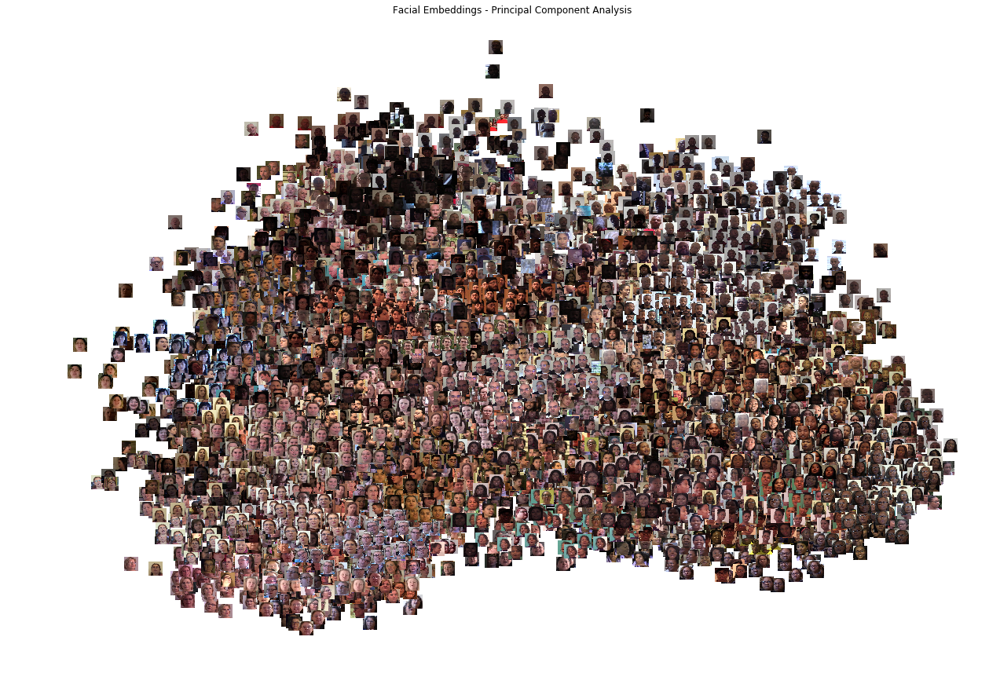

In [11]:
from sklearn.decomposition import PCA

def scatter_thumbnails(data, images, zoom=0.12, colors=None):
    assert len(data) == len(images)

    # reduce embedding dimentions to 2
    x = PCA(n_components=2).fit_transform(data) if len(data[0]) > 2 else data

    # create a scatter plot.
    f = plt.figure(figsize=(22, 15))
    ax = plt.subplot(aspect='equal')
    sc = ax.scatter(x[:,0], x[:,1], s=4)
    _ = ax.axis('off')
    _ = ax.axis('tight')

    # add thumbnails :)
    from matplotlib.offsetbox import OffsetImage, AnnotationBbox
    for i in range(len(images)):
        image = plt.imread(images[i])
        im = OffsetImage(image, zoom=zoom)
        bboxprops = dict(edgecolor=colors[i]) if colors is not None else None
        ab = AnnotationBbox(im, x[i], xycoords='data',
                            frameon=(bboxprops is not None),
                            pad=0.02,
                            bboxprops=bboxprops)
        ax.add_artist(ab)
    return ax

_ = scatter_thumbnails(df.embedding.tolist(), df.face.tolist())
plt.title('Facial Embeddings - Principal Component Analysis')
plt.show()

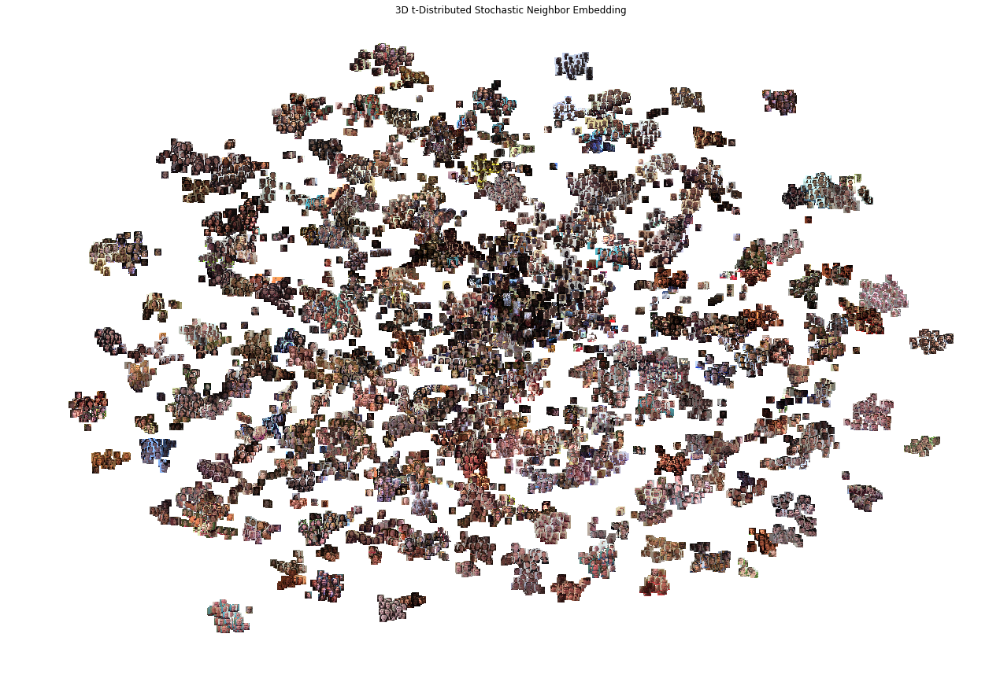

CPU times: user 25min 8s, sys: 9.51 s, total: 25min 18s
Wall time: 25min 2s


In [12]:
%%time
from sklearn.manifold import TSNE
# PCA first to speed it up
x = PCA(n_components=50).fit_transform(df['embedding'].tolist())
x = TSNE(perplexity=50,
         n_components=3).fit_transform(x)

_ = scatter_thumbnails(x, df.face.tolist(), zoom=0.06)
plt.title('3D t-Distributed Stochastic Neighbor Embedding')
plt.show()

In [13]:
# !pip install -q hdbscan
# import hdbscan
import sklearn.cluster as cluster

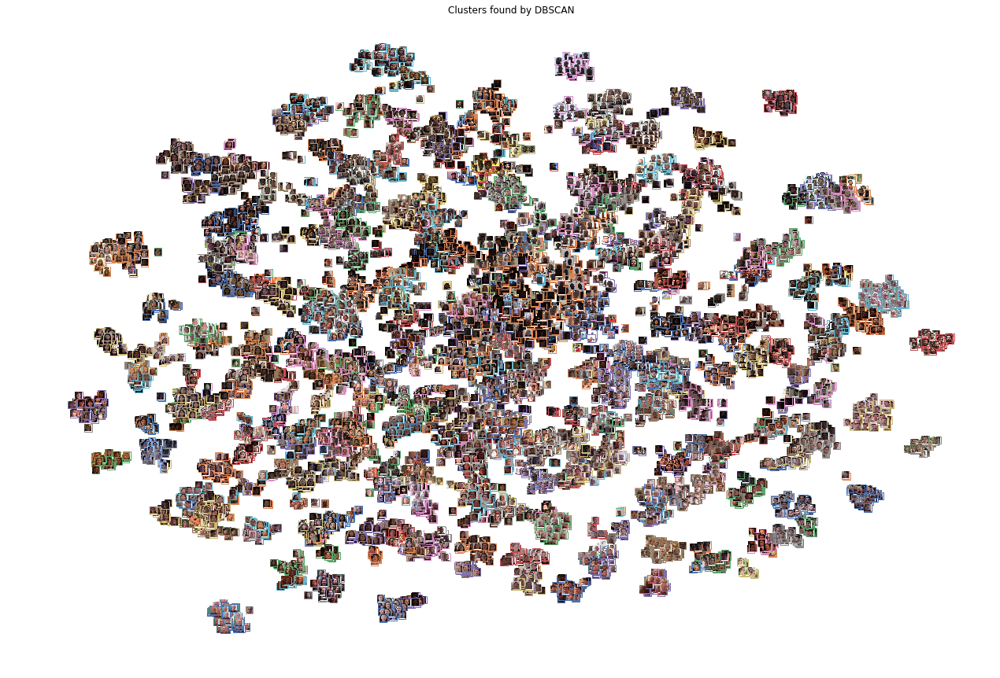

In [14]:
def plot_clusters(data, algorithm, *args, **kwds):
    labels = algorithm(*args, **kwds).fit_predict(data)
    palette = sns.color_palette('deep', np.max(labels) + 1)
    colors = [palette[x] if x >= 0 else (0,0,0) for x in labels]
    ax = scatter_thumbnails(x, df.face.tolist(), 0.06, colors)
    plt.title(f'Clusters found by {algorithm.__name__}')
    return labels

# clusters = plot_clusters(x, hdbscan.HDBSCAN, alpha=1.0, min_cluster_size=2, min_samples=1)
clusters = plot_clusters(x, cluster.DBSCAN, n_jobs=-1, eps=1.0, min_samples=1)
df['cluster'] = clusters

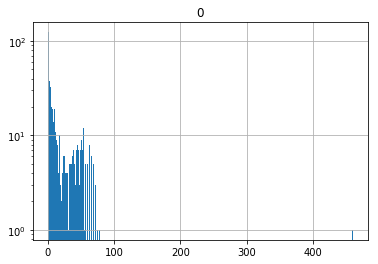

In [15]:
# clusters and the number of images on each one of them
ids, counts = np.unique(clusters, return_counts=True)
_ = pd.DataFrame(counts, index=ids).hist(bins=len(ids), log=True)

In [16]:
from annoy import AnnoyIndex

f = len(df['embedding'][0])
t = AnnoyIndex(f, metric='euclidean')
ntree = 50

for i, vector in enumerate(df['embedding']):
    t.add_item(i, vector)
_  = t.build(ntree)

In [17]:
def get_similar_images_annoy(img_index, n=8, max_dist=1.0):
    vid, face  = df.iloc[img_index, [0, 1]]
    similar_img_ids, dist = t.get_nns_by_item(img_index, n+1, include_distances=True)
    similar_img_ids = [s for s,d in zip(similar_img_ids, dist) if d <= max_dist][1:]  # first item is always its own video
    return vid, face, df.iloc[similar_img_ids], dist

In [18]:
def get_sample_n_similar(sample_idx):
    vid, face, similar, distances = get_similar_images_annoy(sample_idx)
    
    fig = plt.figure(figsize=(15, 7))
    gs = fig.add_gridspec(2, 6)
    ax1 = fig.add_subplot(gs[0:2, 0:2])
    ax2 = fig.add_subplot(gs[0, 2])
    ax3 = fig.add_subplot(gs[0, 3])
    ax4 = fig.add_subplot(gs[0, 4])
    ax5 = fig.add_subplot(gs[0, 5])
    ax6 = fig.add_subplot(gs[1, 2])
    ax7 = fig.add_subplot(gs[1, 3])
    ax8 = fig.add_subplot(gs[1, 4])
    ax9 = fig.add_subplot(gs[1, 5])
    axx = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]
    for ax in axx:
        ax.set_axis_off()
    list_plot = [face] + similar['face'].values.tolist()
    list_cluster = [df.iloc[sample_idx]['cluster']] + similar['cluster'].values.tolist()
    for ax, face, cluster, dist in zip(axx, list_plot, list_cluster, distances):
        ax.imshow(plt.imread(face))
        ax.set_title(f'{face.split("/")[-1][:-4]} @{dist:.2f}\ncluster:{cluster}') # show video filename and distance

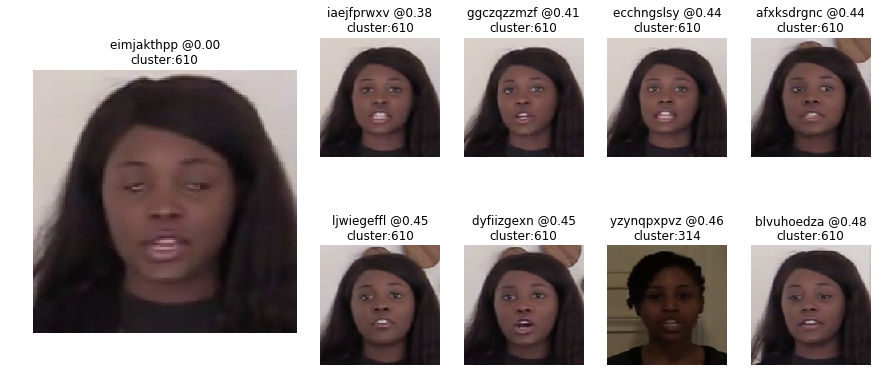

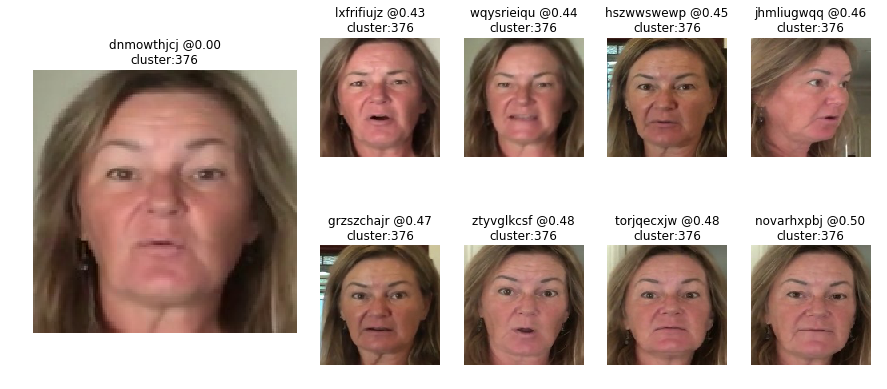

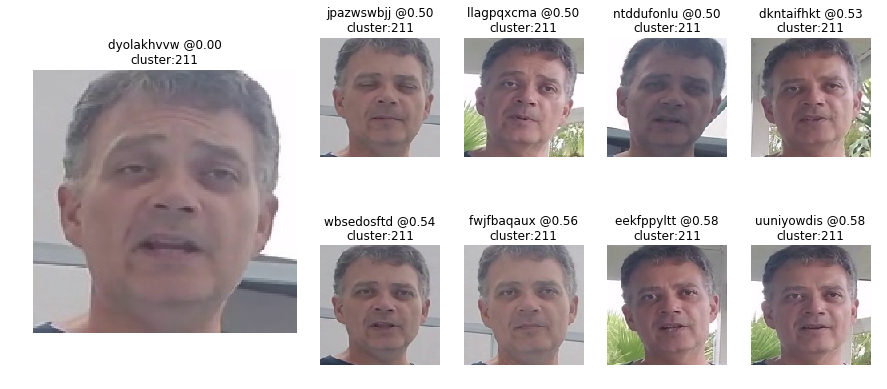

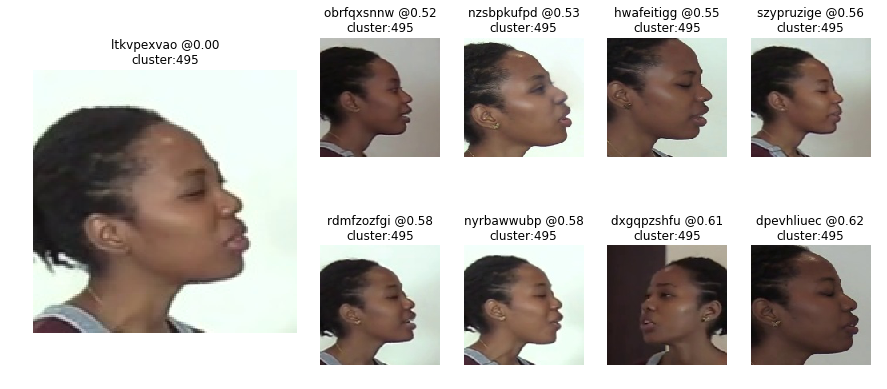

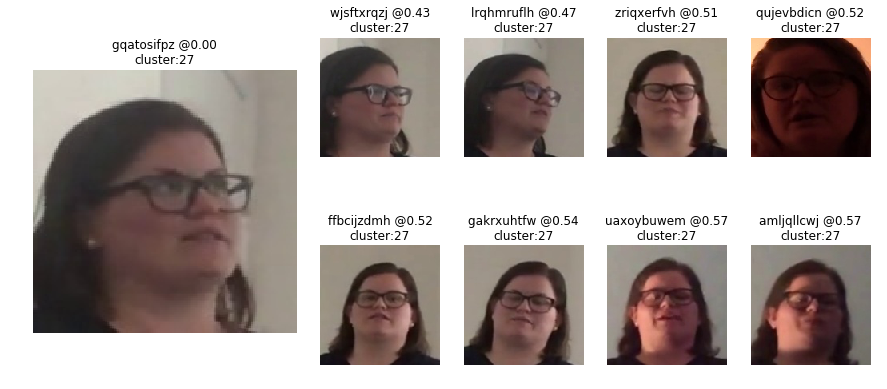

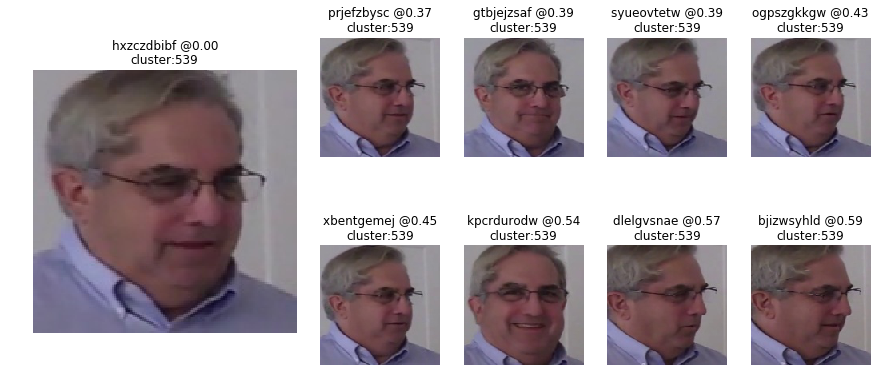

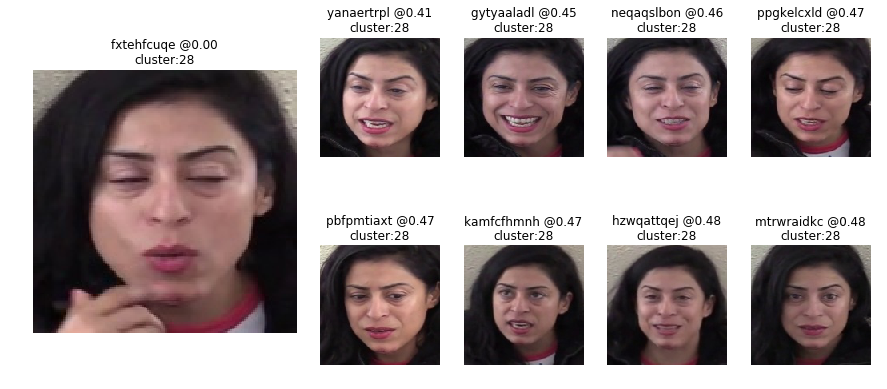

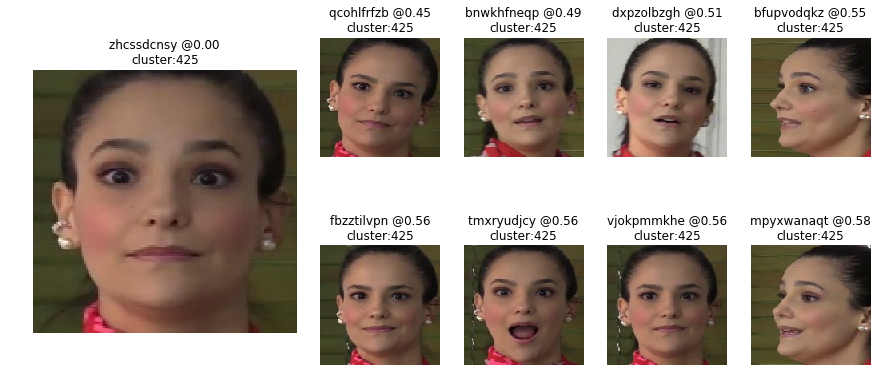

In [19]:
# display samples and their nearest neighbors
for i in np.random.choice(len(df), 8, replace=False):
    get_sample_n_similar(i)

In [20]:
chunks = df.groupby('cluster').chunk.nunique().to_frame('n_chunks')
chunks = chunks.merge(df.groupby('cluster').video.nunique().to_frame('n_videos'),
                     left_index=True, right_index=True).sort_values(by='n_chunks')

print(f'{sum(chunks.n_chunks > 1)} clusters are spread across more than one data chunk')
chunks

131 clusters are spread across more than one data chunk


,n_chunks,n_videos
cluster,,
0,1,63
502,1,1
503,1,5
504,1,3
505,1,3
...,...,...
81,11,43
24,12,43
149,14,49


Cluster 77 with 2 chunks


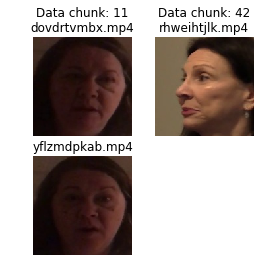

Cluster 252 with 2 chunks


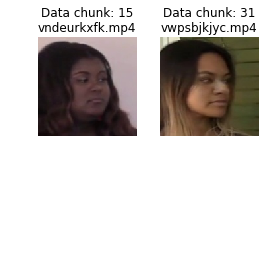

Cluster 45 with 2 chunks


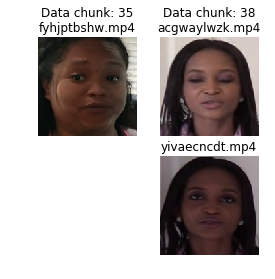

Cluster 54 with 2 chunks


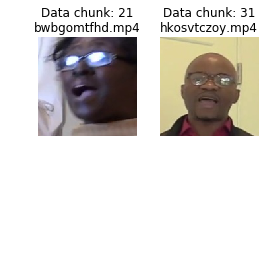

Cluster 209 with 2 chunks


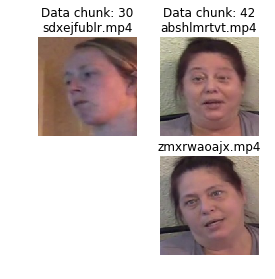

Cluster 343 with 2 chunks


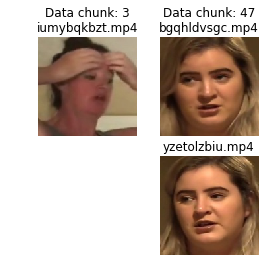

Cluster 415 with 2 chunks


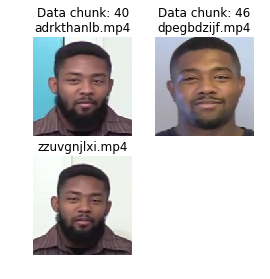

Cluster 239 with 2 chunks


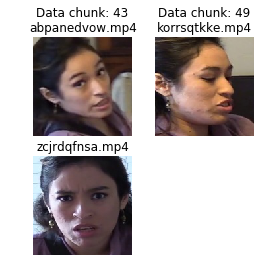

Cluster 325 with 2 chunks


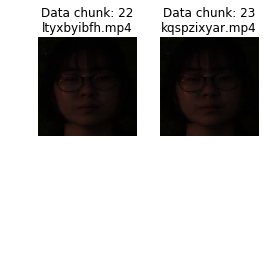

Cluster 21 with 2 chunks


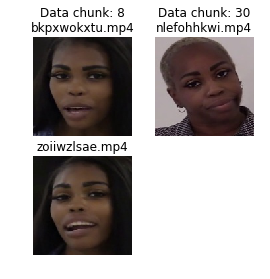

Cluster 87 with 2 chunks


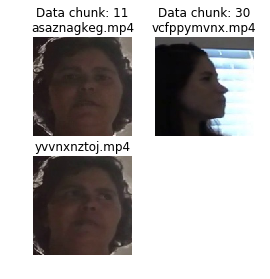

Cluster 393 with 2 chunks


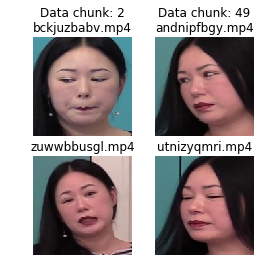

Cluster 345 with 2 chunks


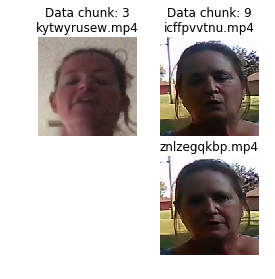

Cluster 495 with 2 chunks


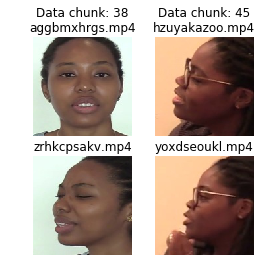

Cluster 76 with 2 chunks


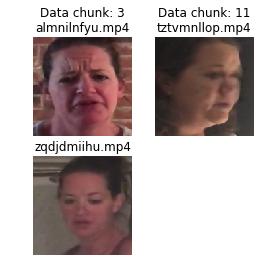

Cluster 44 with 2 chunks


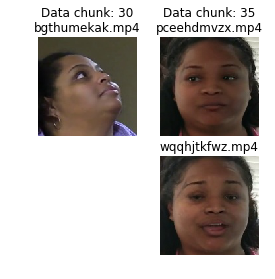

Cluster 72 with 2 chunks


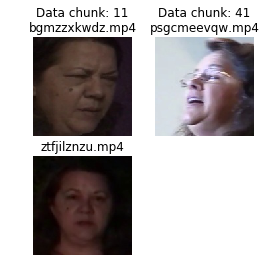

Cluster 240 with 2 chunks


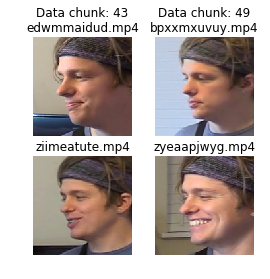

Cluster 33 with 2 chunks


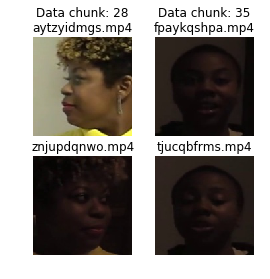

Cluster 53 with 2 chunks


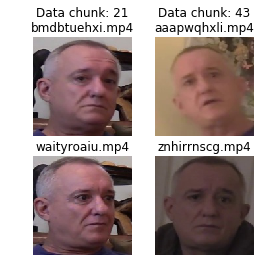

Cluster 57 with 2 chunks


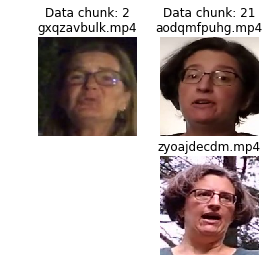

Cluster 731 with 2 chunks


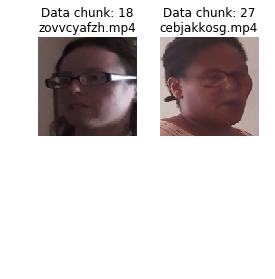

Cluster 32 with 2 chunks


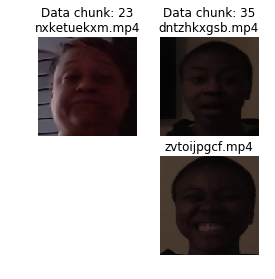

Cluster 60 with 2 chunks


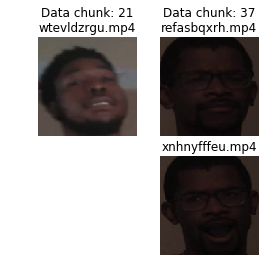

Cluster 387 with 2 chunks


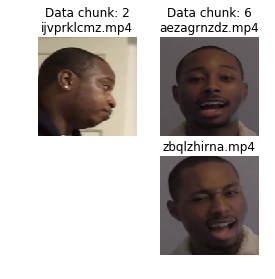

Cluster 336 with 2 chunks


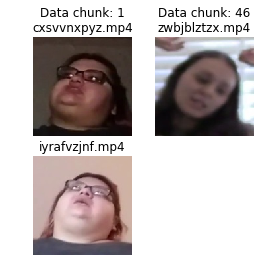

Cluster 63 with 2 chunks


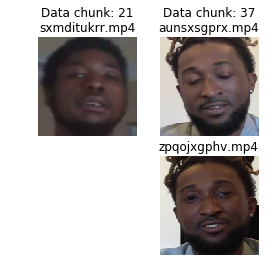

Cluster 214 with 2 chunks


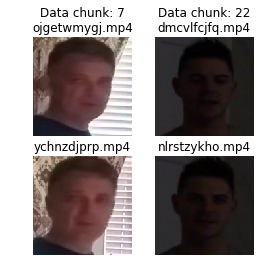

Cluster 540 with 2 chunks


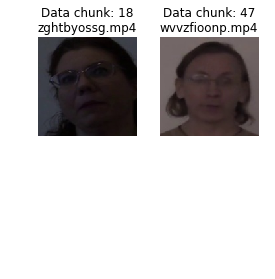

Cluster 560 with 2 chunks


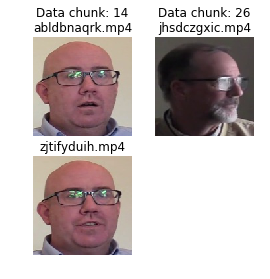

Cluster 66 with 2 chunks


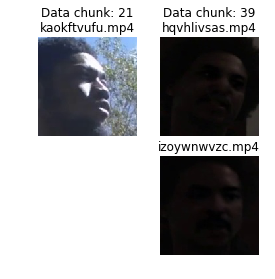

Cluster 400 with 2 chunks


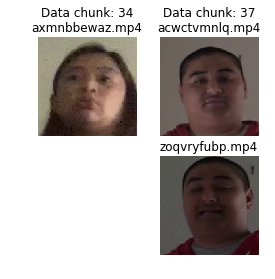

Cluster 405 with 2 chunks


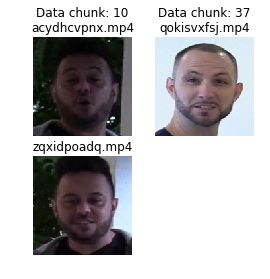

Cluster 550 with 2 chunks


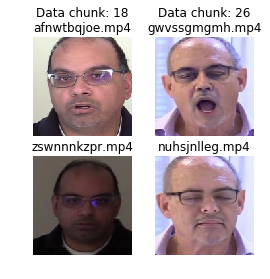

Cluster 203 with 2 chunks


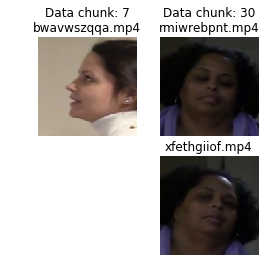

Cluster 23 with 2 chunks


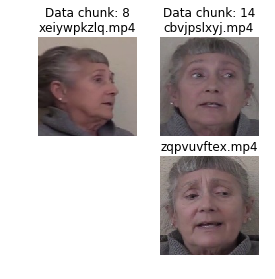

Cluster 428 with 2 chunks


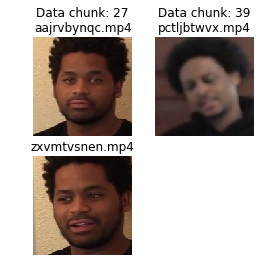

Cluster 509 with 2 chunks


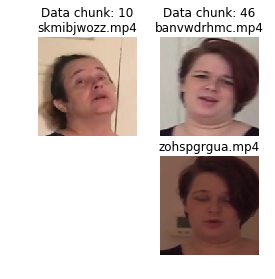

Cluster 93 with 2 chunks


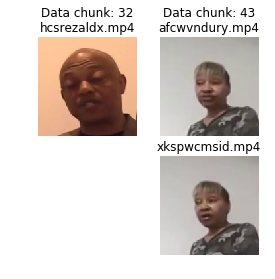

Cluster 131 with 2 chunks


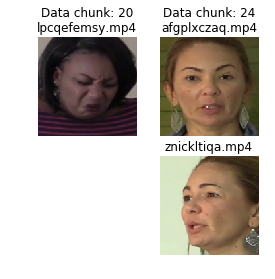

Cluster 449 with 2 chunks


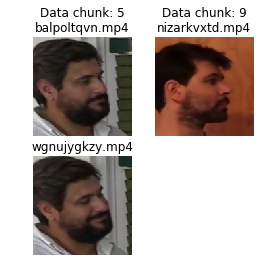

Cluster 362 with 2 chunks


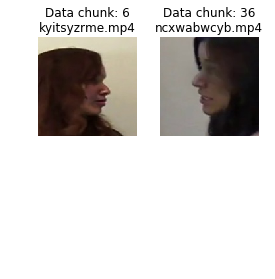

Cluster 10 with 2 chunks


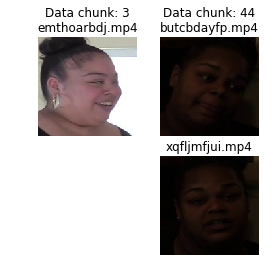

Cluster 295 with 2 chunks


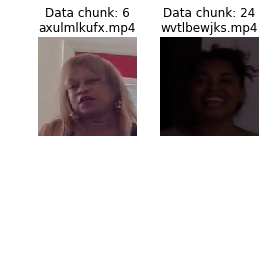

Cluster 9 with 2 chunks


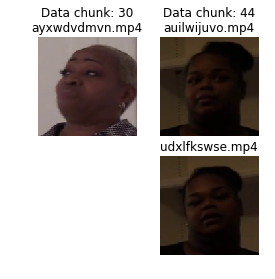

Cluster 177 with 2 chunks


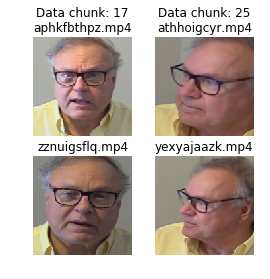

Cluster 138 with 2 chunks


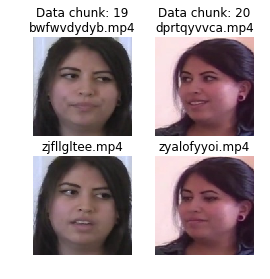

Cluster 139 with 2 chunks


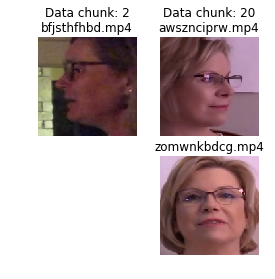

Cluster 175 with 2 chunks


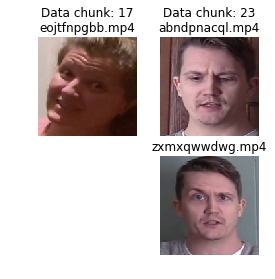

Cluster 458 with 2 chunks


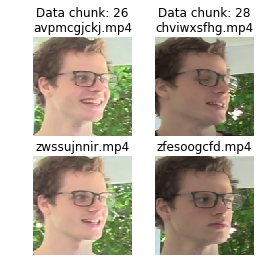

Cluster 290 with 2 chunks


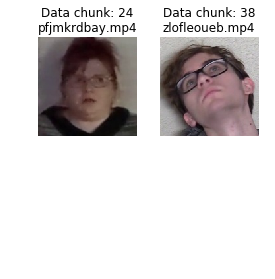

Cluster 271 with 2 chunks


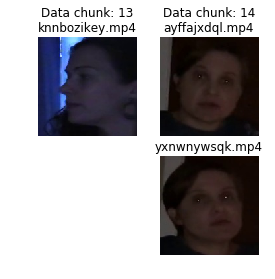

Cluster 287 with 2 chunks


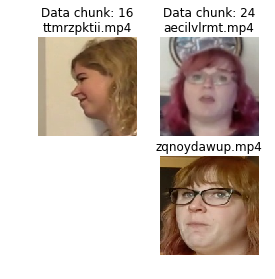

Cluster 372 with 2 chunks


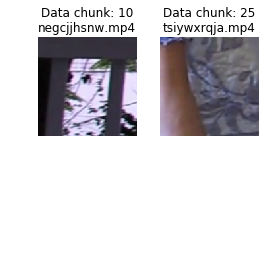

Cluster 232 with 2 chunks


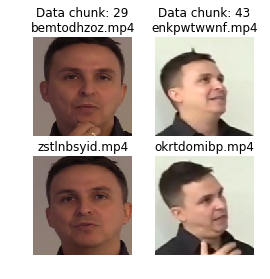

Cluster 283 with 2 chunks


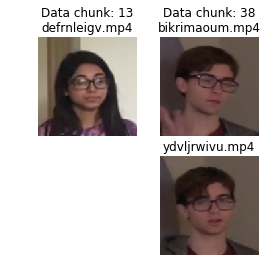

Cluster 167 with 2 chunks


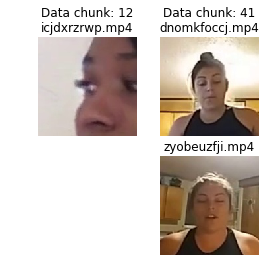

Cluster 156 with 2 chunks


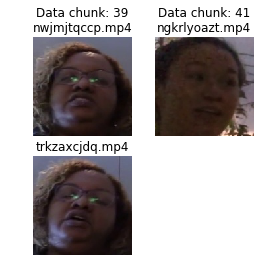

Cluster 3 with 2 chunks


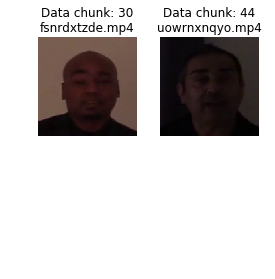

Cluster 159 with 2 chunks


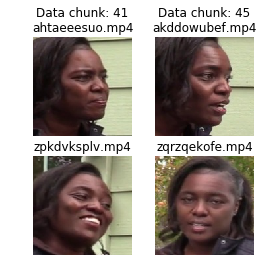

Cluster 278 with 2 chunks


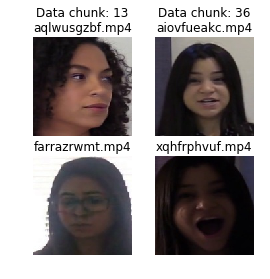

Cluster 2 with 2 chunks


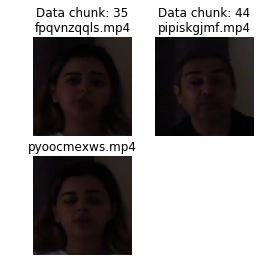

Cluster 298 with 2 chunks


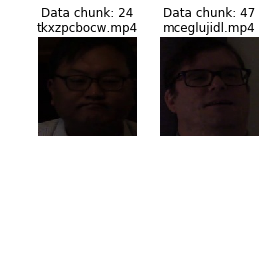

Cluster 91 with 2 chunks


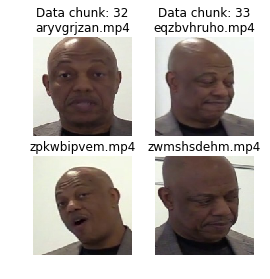

Cluster 632 with 2 chunks


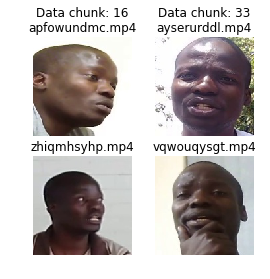

Cluster 126 with 2 chunks


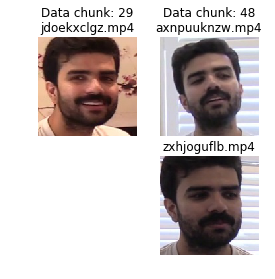

Cluster 94 with 2 chunks


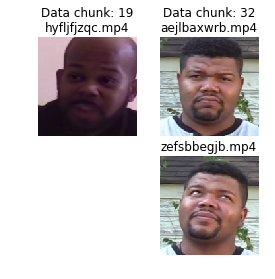

Cluster 192 with 2 chunks


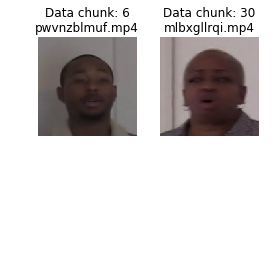

Cluster 259 with 2 chunks


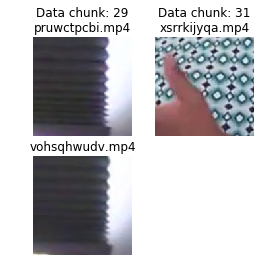

Cluster 427 with 2 chunks


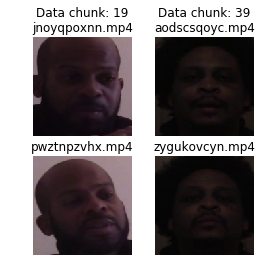

Cluster 244 with 2 chunks


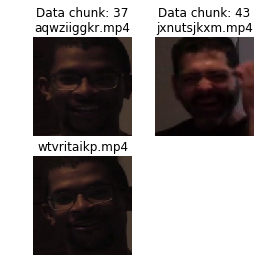

Cluster 430 with 2 chunks


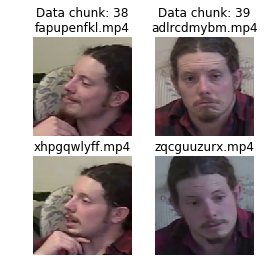

Cluster 236 with 2 chunks


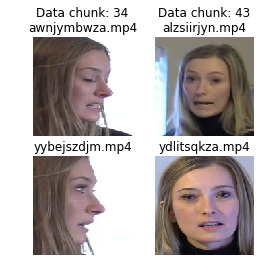

Cluster 107 with 2 chunks


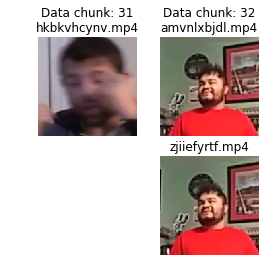

Cluster 568 with 2 chunks


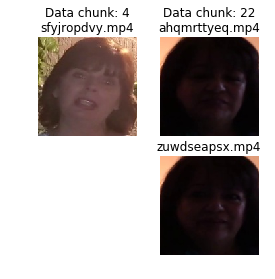

Cluster 569 with 2 chunks


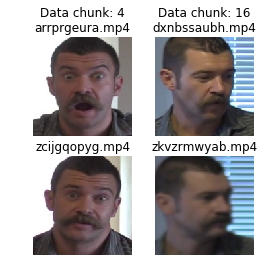

Cluster 180 with 2 chunks


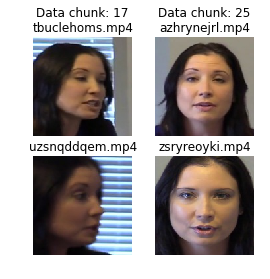

Cluster 570 with 2 chunks


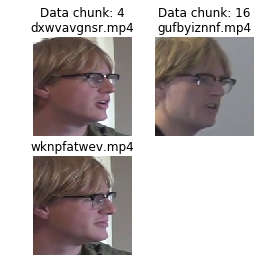

Cluster 436 with 2 chunks


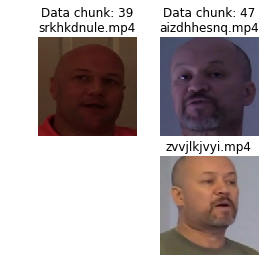

Cluster 15 with 2 chunks


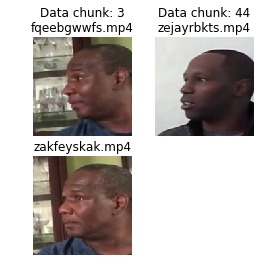

Cluster 648 with 2 chunks


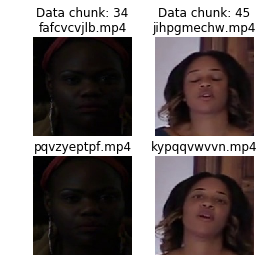

Cluster 235 with 2 chunks


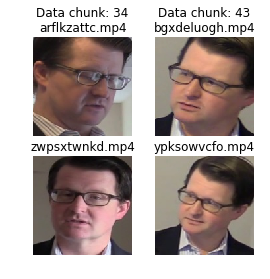

Cluster 116 with 2 chunks


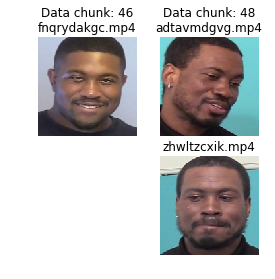

Cluster 575 with 2 chunks


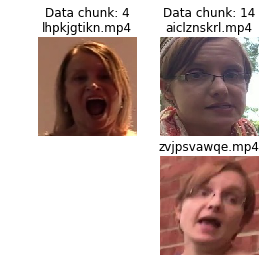

Cluster 119 with 2 chunks


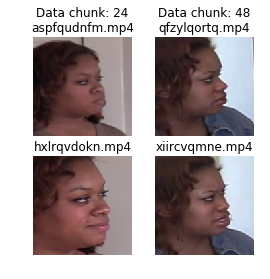

Cluster 120 with 2 chunks


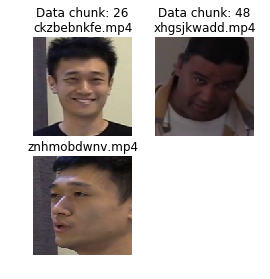

Cluster 576 with 2 chunks


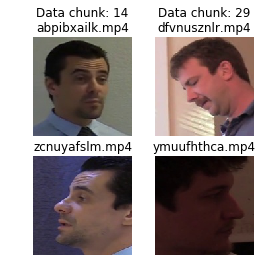

Cluster 184 with 2 chunks


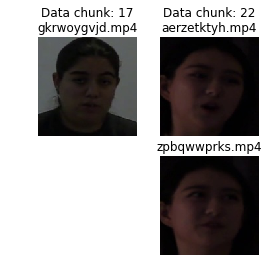

Cluster 16 with 2 chunks


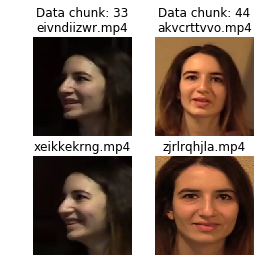

Cluster 34 with 3 chunks


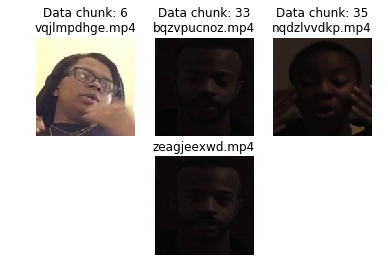

Cluster 473 with 3 chunks


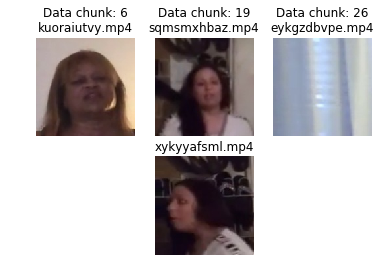

Cluster 229 with 3 chunks


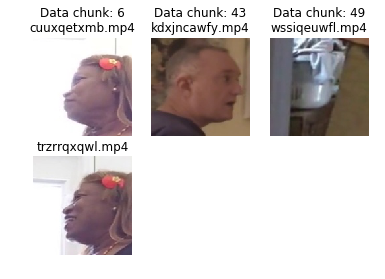

Cluster 188 with 3 chunks


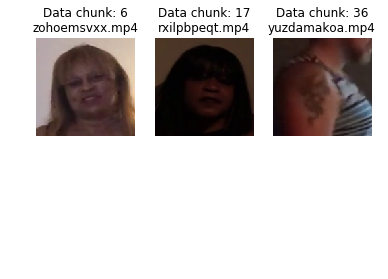

Cluster 104 with 3 chunks


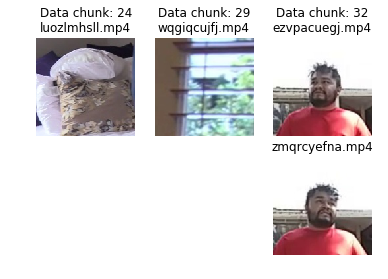

Cluster 338 with 3 chunks


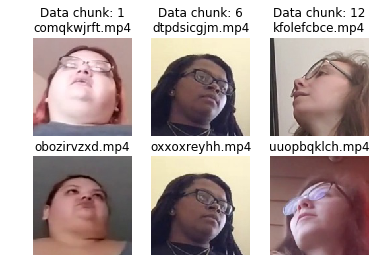

Cluster 58 with 3 chunks


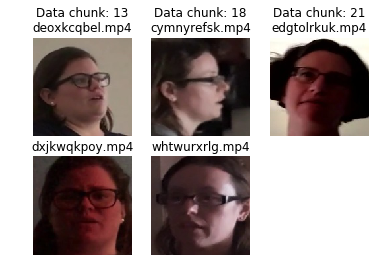

Cluster 164 with 3 chunks


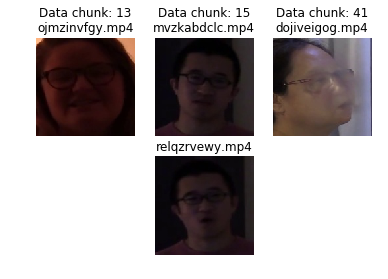

Cluster 151 with 3 chunks


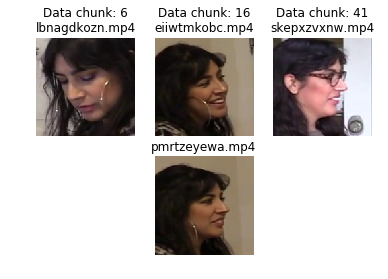

Cluster 178 with 3 chunks


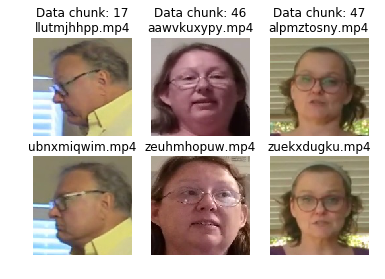

Cluster 114 with 3 chunks


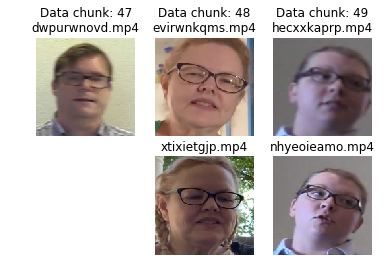

Cluster 335 with 3 chunks


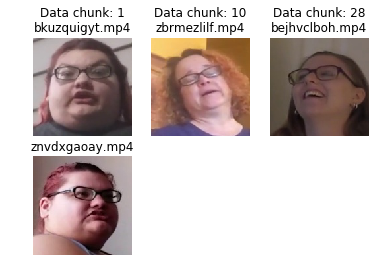

Cluster 324 with 3 chunks


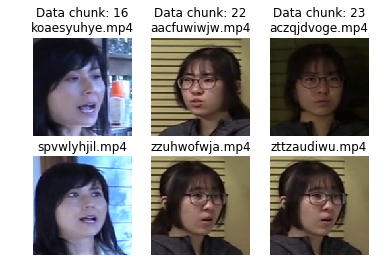

Cluster 326 with 3 chunks


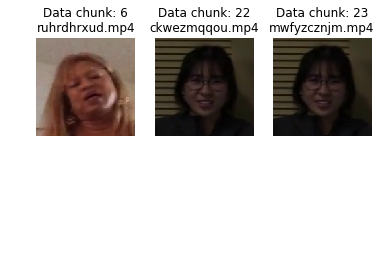

Cluster 186 with 3 chunks


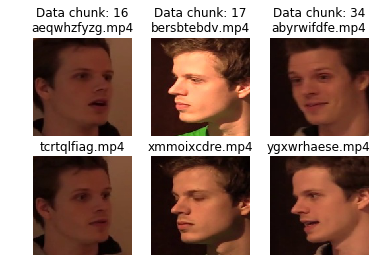

Cluster 453 with 3 chunks


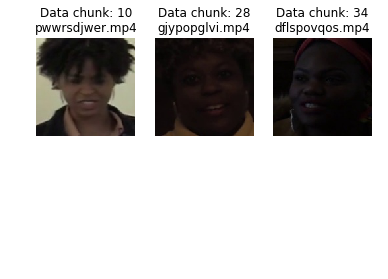

Cluster 410 with 3 chunks


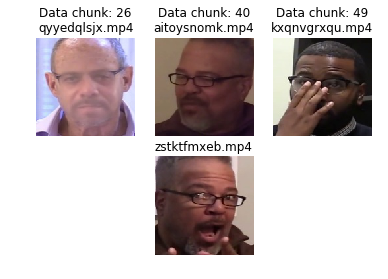

Cluster 270 with 4 chunks


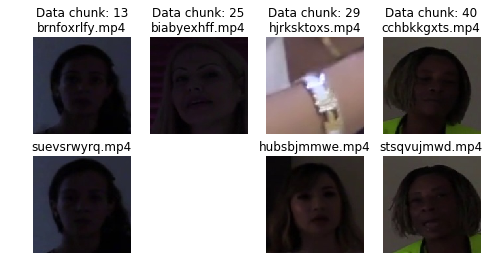

Cluster 47 with 4 chunks


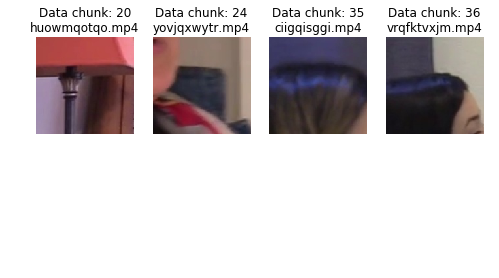

Cluster 64 with 4 chunks


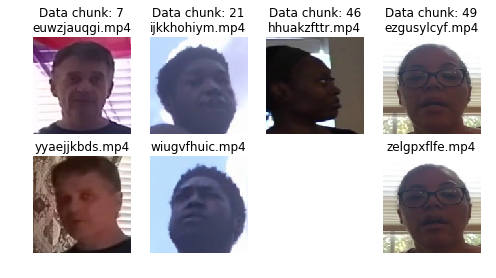

Cluster 52 with 4 chunks


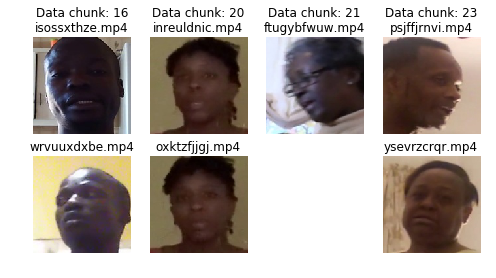

Cluster 217 with 4 chunks


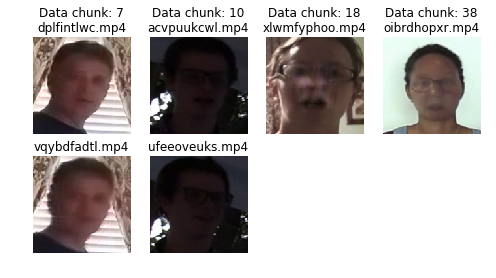

Cluster 106 with 4 chunks


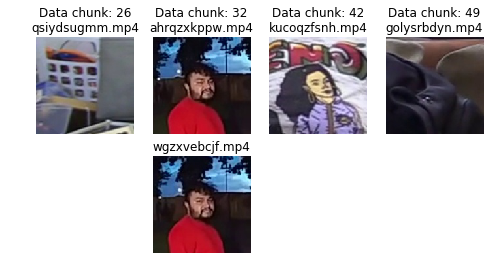

Cluster 5 with 5 chunks


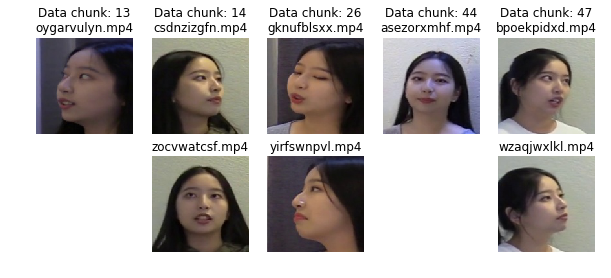

Cluster 170 with 5 chunks


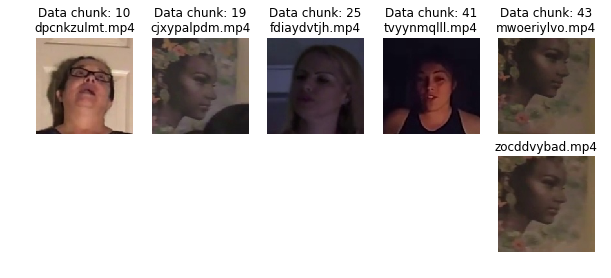

Cluster 297 with 5 chunks


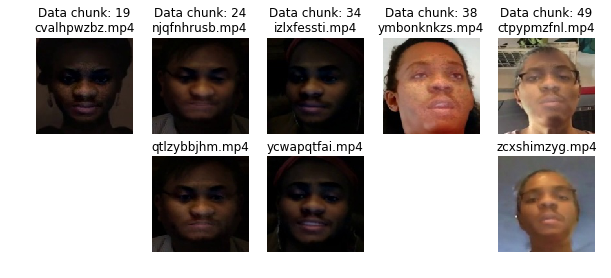

Cluster 18 with 5 chunks


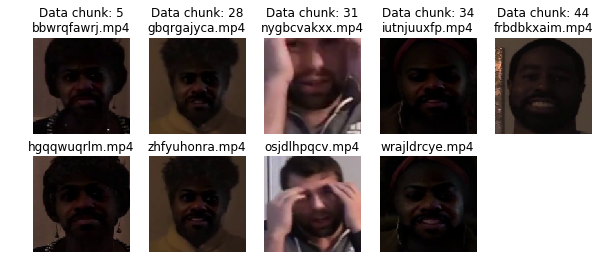

Cluster 73 with 5 chunks


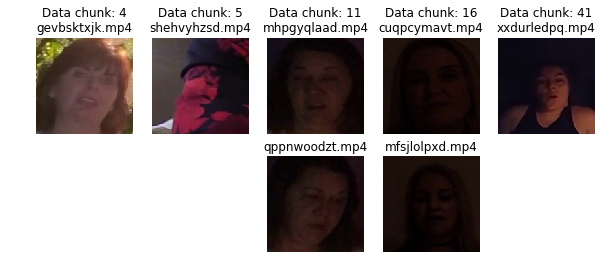

Cluster 27 with 6 chunks


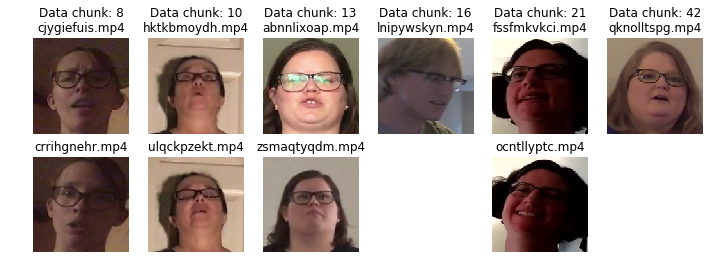

Cluster 65 with 6 chunks


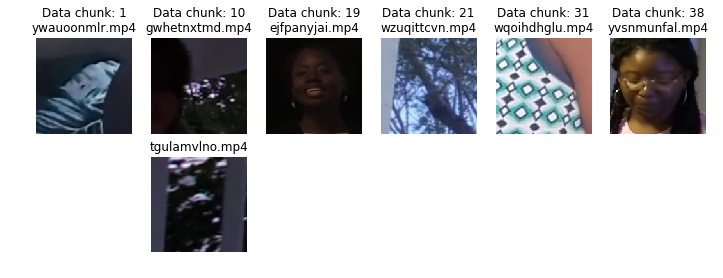

Cluster 476 with 6 chunks


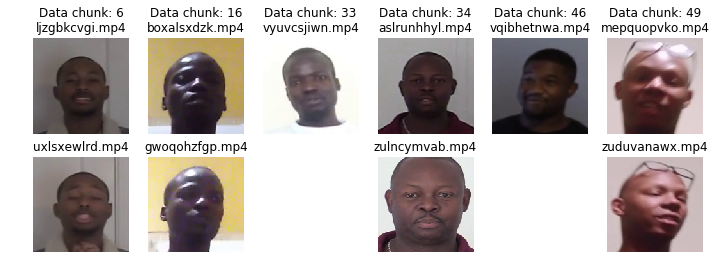

Cluster 59 with 6 chunks


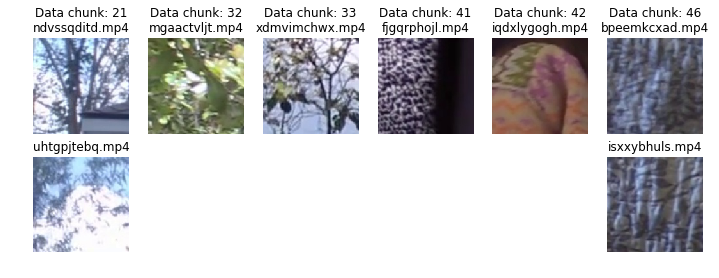

Cluster 195 with 8 chunks


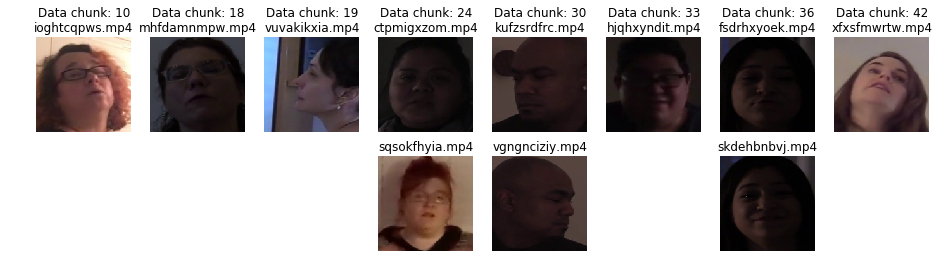

Cluster 124 with 8 chunks


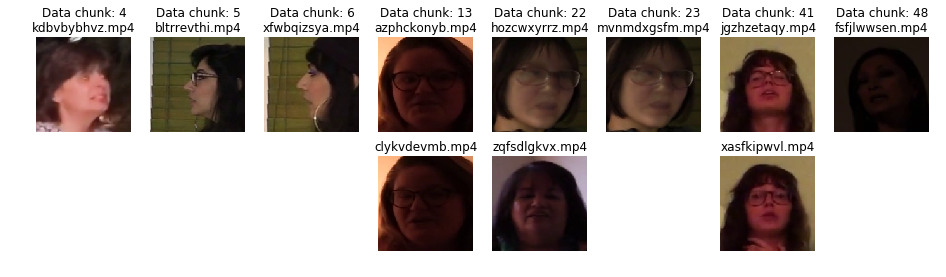

Cluster 224 with 9 chunks


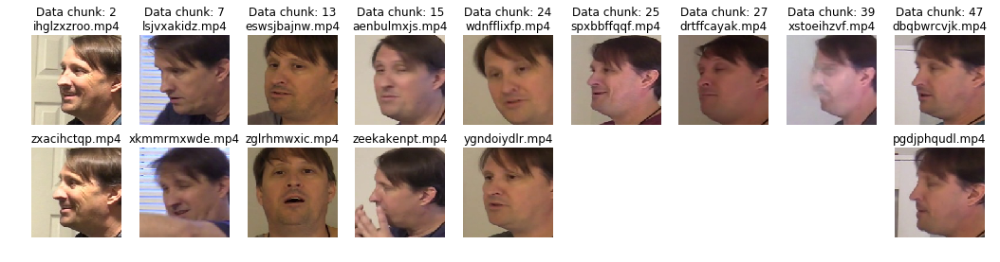

Cluster 81 with 11 chunks


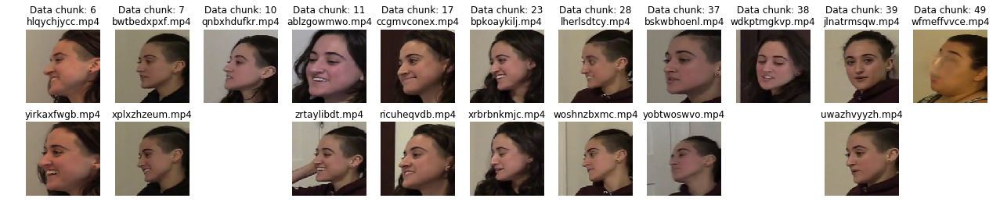

Cluster 24 with 12 chunks


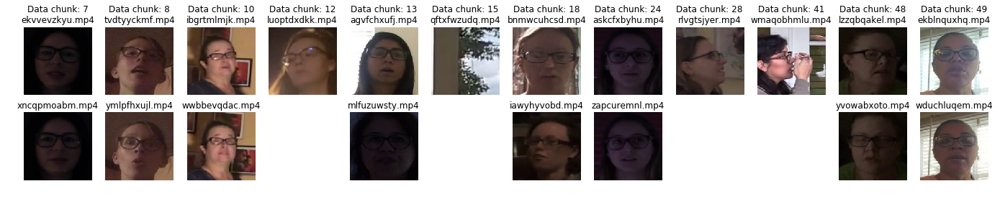

Cluster 149 with 14 chunks


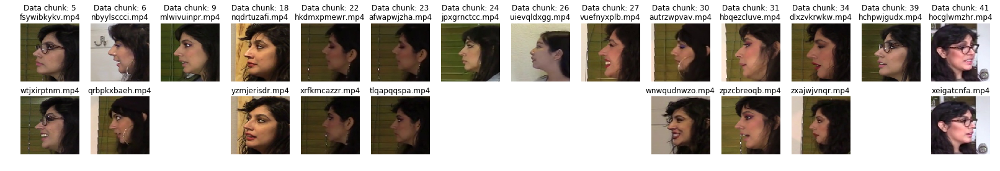

Cluster 61 with 19 chunks


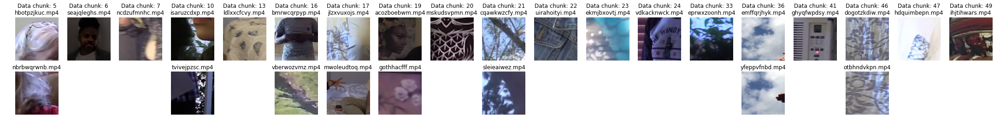

In [21]:
# sample 2 images of each ['cluster', 'chunk'] pair 
mixed_clusters = chunks[(chunks.n_chunks > 1) & (chunks.n_videos < 100)].index.values
video_samples = df[df.cluster.isin(mixed_clusters)].groupby(['cluster', 'chunk']).face
video_samples = video_samples.agg(['min', 'max']).reset_index()

for cluster in mixed_clusters:
    chunk_samples = video_samples[video_samples.cluster == cluster]
    fig, axes = plt.subplots(2, len(chunk_samples), figsize=(len(chunk_samples)*2, 4))
    print(f'Cluster {cluster} with {len(chunk_samples)} chunks')
    for i, (idx, row) in enumerate(chunk_samples.iterrows()):
        axes[0, i].imshow(plt.imread(row['min']))
        axes[0, i].set_axis_off()
        axes[0, i].set_title(f"""Data chunk: {row.chunk}
{row['min'].split('/')[-1][:-4]}.mp4""")
        if row['max'] != row['min']:
            axes[1, i].imshow(plt.imread(row['max']))
            axes[1, i].set_title(f"""{row['max'].split('/')[-1][:-4]}.mp4""")
        axes[1, i].set_axis_off()
    plt.show()

In [22]:
chunks = df.groupby('cluster').chunk.unique().to_frame('chunks')
chunks = chunks[chunks.chunks.apply(lambda c: len(c)) > 1] # filter non-unique clusters
chunks_df = pd.DataFrame(range(50), columns=['chunk'])
chunks_df['n_nonunique_clusters'] = 0
chunks_df['nonunique_clusters'] = [[] for _ in range(50)]
for i in range(50):
    chunks_df.loc[i, 'n_nonunique_clusters'] = len(chunks[chunks.chunks.apply(lambda chunks: i in chunks)])
    chunks_df.loc[i, 'nonunique_clusters'].extend(chunks[chunks.chunks.apply(lambda chunks: i in chunks)].index.tolist())
chunks_df.sort_values(by='n_nonunique_clusters').head()

,chunk,n_nonunique_clusters,nonunique_clusters
0,0,0,[]
9,9,3,"[149, 345, 449]"
40,40,4,"[1, 270, 410, 415]"
12,12,4,"[1, 24, 167, 338]"
27,27,5,"[1, 149, 224, 428, 731]"


In [23]:
# clean up working dir
if not is_interactive():
    shutil.rmtree(Path(faces_path))

In [24]:
# save face clusters
df.to_csv('face_clusters.csv.zip', index=False)
df[['video', 'chunk', 'cluster']].to_feather('face_clusters.feather')
df

,video,face,chunk,embedding,cluster
0,extmbbwsdy.mp4,/kaggle/working/faces/extmbbwsdy.jpg,44,"[0.0032058146316558123, -0.051718443632125854,...",0
1,yadnjfpztj.mp4,/kaggle/working/faces/yadnjfpztj.jpg,44,"[-0.04966510832309723, 0.0015917506534606218, ...",0
2,nfksmyvixl.mp4,/kaggle/working/faces/nfksmyvixl.jpg,44,"[-0.046701326966285706, -0.02837006375193596, ...",0
3,ipijpsawpc.mp4,/kaggle/working/faces/ipijpsawpc.jpg,44,"[-0.01758013665676117, -0.032523468136787415, ...",0
4,wetxtmuqbk.mp4,/kaggle/working/faces/wetxtmuqbk.jpg,44,"[-0.0019267444731667638, -0.02202877216041088,...",0
...,...,...,...,...,...
18707,eahvhdfruw.mp4,/kaggle/working/faces/eahvhdfruw.jpg,18,"[0.0014572048094123602, -0.007960908114910126,...",765
18708,vptrvimiek.mp4,/kaggle/working/faces/vptrvimiek.jpg,18,"[-0.019487127661705017, -0.010125522501766682,...",765
18709,gzfxxpqxvv.mp4,/kaggle/working/faces/gzfxxpqxvv.jpg,18,"[-0.004673020448535681, -0.03176964819431305, ...",765
18710,qawfrjdwud.mp4,/kaggle/working/faces/qawfrjdwud.jpg,18,"[-0.0017147923354059458, -0.019261395558714867...",765


In [25]:
meta['cluster'] = -1
meta.loc[df.video, 'cluster'] = df.cluster.values

# propagate real video clusters to their fake versions
for index, real in tqdm(meta[~meta.cluster.isnull()].iterrows(),
                        total=len(meta[~meta.cluster.isnull()])):
    meta.loc[meta.original == index, 'cluster'] = int(real.cluster)

meta.reset_index().to_feather('metadata.feather')
meta[~meta.cluster.isnull()]

,label,split,original,chunk,cluster
szfifyvsso.mp4,FAKE,train,wsxyuwcrfx.mp4,44,0
ubmugwqfol.mp4,FAKE,train,yadnjfpztj.mp4,44,0
vjyvxalibt.mp4,FAKE,train,wcmqvldxtk.mp4,44,0
prglmoibam.mp4,FAKE,train,gmfowavzuz.mp4,44,0
eyqjufadve.mp4,FAKE,train,fxsscbdili.mp4,44,0
...,...,...,...,...,...
ffeteuoqbr.mp4,FAKE,train,gzfxxpqxvv.mp4,18,765
womczewzwr.mp4,FAKE,train,annmtetkqa.mp4,18,765
gzfxxpqxvv.mp4,REAL,train,NaN,18,765
qawfrjdwud.mp4,REAL,train,NaN,18,765


In [26]:
# exported files
!ls -sh face_clusters*
!ls -sh metadata*

 86M face_clusters.csv.zip  624K face_clusters.feather
7.7M metadata.feather


In [2]:
from sklearn.metrics import log_loss
log_loss(["REAL", "FAKE", "FAKE", "REAL"],
         [[.1, .9], [.9, .1], [.8, .2], [.35, .65]])

0.21616187468057912

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pylab as plt
import cv2
plt.style.use('ggplot')
from IPython.display import Video
from IPython.display import HTML

In [4]:
!ls -GFlash ../input/deepfake-detection-challenge

total 56K
4.0K drwxr-xr-x 4 nobody 4.0K Dec 11  2019 ./
4.0K drwxr-xr-x 6 root   4.0K Sep  7 07:34 ../
8.0K -rw-r--r-- 1 nobody 6.7K Dec 11  2019 sample_submission.csv
 20K drwxr-xr-x 2 nobody  20K Dec 11  2019 test_videos/
 20K drwxr-xr-x 2 nobody  20K Dec 11  2019 train_sample_videos/


In [5]:
!du -sh ../input/deepfake-detection-challenge/

4.2G	../input/deepfake-detection-challenge/


In [6]:
train_sample_metadata = pd.read_json('../input/deepfake-detection-challenge/train_sample_videos/metadata.json').T
train_sample_metadata.head()

,label,split,original
aagfhgtpmv.mp4,FAKE,train,vudstovrck.mp4
aapnvogymq.mp4,FAKE,train,jdubbvfswz.mp4
abarnvbtwb.mp4,REAL,train,None
abofeumbvv.mp4,FAKE,train,atvmxvwyns.mp4
abqwwspghj.mp4,FAKE,train,qzimuostzz.mp4


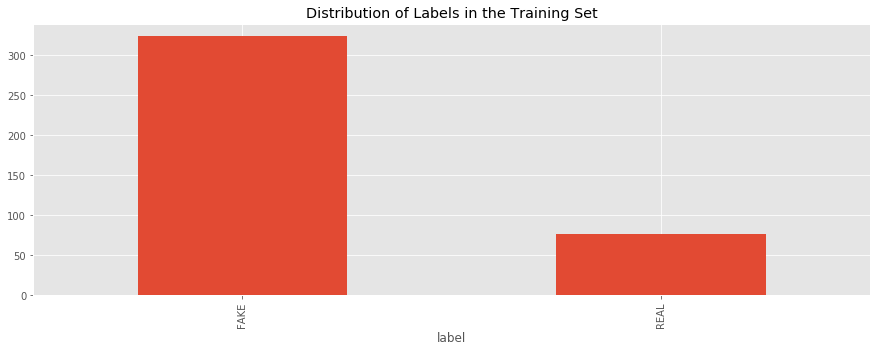

In [7]:
train_sample_metadata.groupby('label')['label'].count().plot(figsize=(15, 5), kind='bar', title='Distribution of Labels in the Training Set')
plt.show()

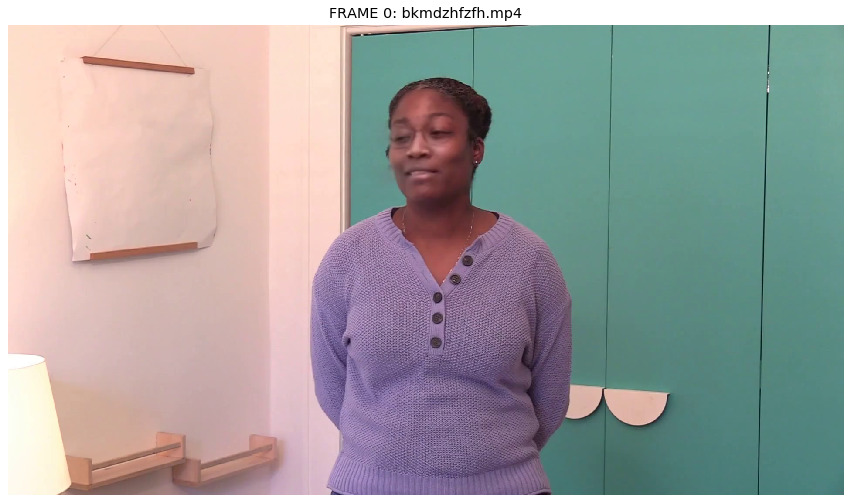

In [11]:
import cv2 as cv
import os
import matplotlib.pylab as plt
train_dir = '/kaggle/input/deepfake-detection-challenge/train_sample_videos/'
fig, ax = plt.subplots(1,1, figsize=(15, 15))
train_video_files = [train_dir + x for x in os.listdir(train_dir)]
# video_file = train_video_files[30]
video_file = '../input/deepfake-detection-challenge/train_sample_videos/bkmdzhfzfh.mp4'
cap = cv.VideoCapture(video_file)
success, image = cap.read()
image = cv.cvtColor(image, cv.COLOR_BGR2RGB)
cap.release()   
ax.imshow(image)
ax.xaxis.set_visible(False)
ax.yaxis.set_visible(False)
ax.title.set_text(f"FRAME 0: {video_file.split('/')[-1]}")
plt.grid(False)

In [12]:
!pip install face_recognition

     |████████████████████████████████| 3.2MB 3.5MB/s eta 0:00:01
     |████████████████████████████████| 100.2MB 39.3MB/s eta 0:00:01    |████████████████████▏           | 63.1MB 43.9MB/s eta 0:00:01
  Created wheel for dlib: filename=dlib-19.21.0-cp36-cp36m-linux_x86_64.whl size=3878198 sha256=a1ef613d3e1b1e4f4021b90c49b81a1c62839e6165ba82a6b640a3f4514cba3d
  Stored in directory: /root/.cache/pip/wheels/e3/fd/51/22af51f198c3d1adde947c1189c6dfc70923d70c5b4fe19987
  Created wheel for face-recognition-models: filename=face_recognition_models-0.3.0-py2.py3-none-any.whl size=100566176 sha256=6aaa3bd530e6015b82b1045a3accddec200284242791b5d71b182cd64224871f
  Stored in directory: /root/.cache/pip/wheels/d2/99/18/59c6c8f01e39810415c0e63f5bede7d83dfb0ffc039865465f
Successfully built dlib face-recognition-models


I found 1 face(s) in this photograph.
A face is located at pixel location Top: 167, Left: 835, Bottom: 390, Right: 1058


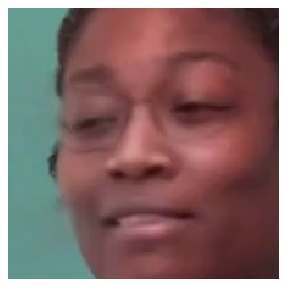

In [13]:
import face_recognition
face_locations = face_recognition.face_locations(image)

# https://github.com/ageitgey/face_recognition/blob/master/examples/find_faces_in_picture.py
from PIL import Image

print("I found {} face(s) in this photograph.".format(len(face_locations)))

for face_location in face_locations:

    # Print the location of each face in this image
    top, right, bottom, left = face_location
    print("A face is located at pixel location Top: {}, Left: {}, Bottom: {}, Right: {}".format(top, left, bottom, right))

    # You can access the actual face itself like this:
    face_image = image[top:bottom, left:right]
    fig, ax = plt.subplots(1,1, figsize=(5, 5))
    plt.grid(False)
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    ax.imshow(face_image)


In [14]:


face_landmarks_list = face_recognition.face_landmarks(image)



The chin in this face has the following points: [(879, 272), (877, 293), (879, 314), (884, 335), (892, 355), (903, 375), (915, 392), (930, 404), (952, 407), (979, 403), (1004, 393), (1029, 380), (1050, 362), (1065, 340), (1071, 312), (1072, 285), (1071, 258)]
The left_eyebrow in this face has the following points: [(882, 233), (887, 222), (897, 216), (910, 214), (922, 219)]
The right_eyebrow in this face has the following points: [(959, 213), (975, 203), (993, 201), (1012, 206), (1026, 218)]
The nose_bridge in this face has the following points: [(941, 248), (939, 262), (937, 275), (935, 290)]
The nose_tip in this face has the following points: [(920, 308), (929, 310), (940, 312), (952, 308), (964, 305)]
The left_eye in this face has the following points: [(894, 264), (901, 259), (911, 258), (924, 259), (913, 263), (902, 265)]
The right_eye in this face has the following points: [(971, 254), (982, 249), (994, 248), (1007, 251), (995, 254), (983, 255)]
The top_lip in this face has the f

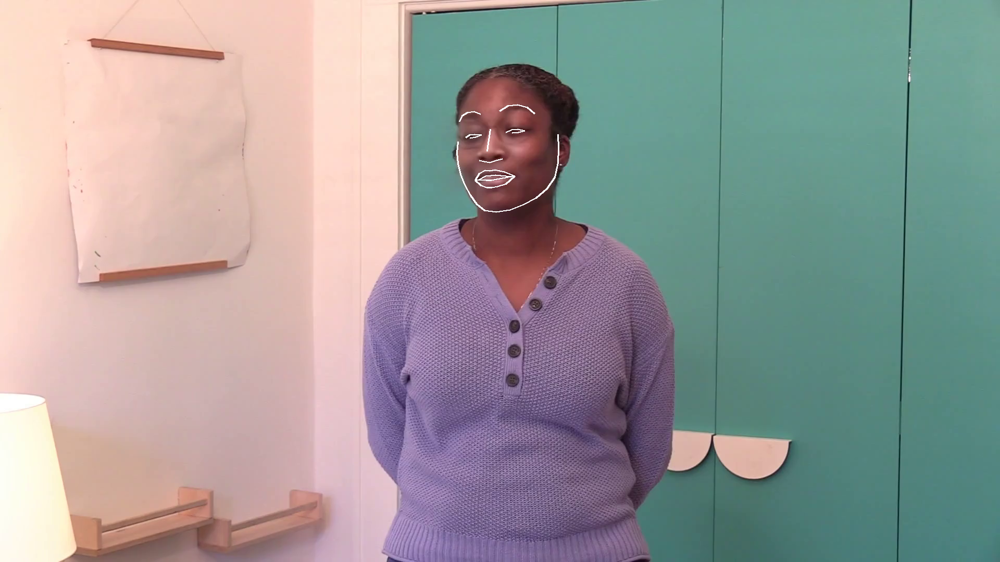

In [15]:
from PIL import Image, ImageDraw
pil_image = Image.fromarray(image)
d = ImageDraw.Draw(pil_image)

for face_landmarks in face_landmarks_list:

    # Print the location of each facial feature in this image
    for facial_feature in face_landmarks.keys():
        print("The {} in this face has the following points: {}".format(facial_feature, face_landmarks[facial_feature]))

    # Let's trace out each facial feature in the image with a line!
    for facial_feature in face_landmarks.keys():
        d.line(face_landmarks[facial_feature], width=3)

# Show the picture
display(pil_image)

IndexError: index 38 is out of bounds for axis 0 with size 38

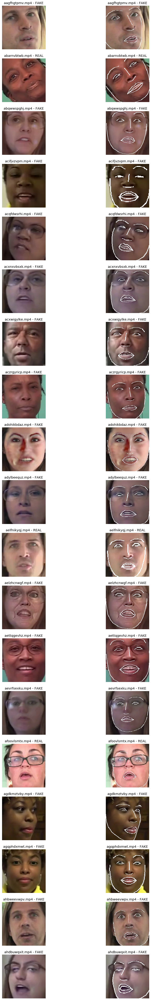

In [28]:
fig, axs = plt.subplots(19, 2, figsize=(15, 80))
axs = np.array(axs)
axs = axs.reshape(-1)
i = 0
for fn in train_sample_metadata.index[:24]:
    label = train_sample_metadata.loc[fn]['label']
    orig = train_sample_metadata.loc[fn]['label']
    video_file = f'/kaggle/input/deepfake-detection-challenge/train_sample_videos/{fn}'
    ax = axs[i]
    cap = cv.VideoCapture(video_file)
    success, image = cap.read()
    image = cv.cvtColor(image, cv.COLOR_BGR2RGB)
    face_locations = face_recognition.face_locations(image)
    if len(face_locations) > 0:
        # Print first face
        face_location = face_locations[0]
        top, right, bottom, left = face_location
        face_image = image[top:bottom, left:right]
        ax.imshow(face_image)
        ax.grid(False)
        ax.title.set_text(f'{fn} - {label}')
        ax.xaxis.set_visible(False)
        ax.yaxis.set_visible(False)
        # Find landmarks
        face_landmarks_list = face_recognition.face_landmarks(face_image)
        face_landmarks = face_landmarks_list[0]
        pil_image = Image.fromarray(face_image)
        d = ImageDraw.Draw(pil_image)
        for facial_feature in face_landmarks.keys():
            d.line(face_landmarks[facial_feature], width=2)
        landmark_face_array = np.array(pil_image)
        ax2 = axs[i+1]
        ax2.imshow(landmark_face_array)
        ax2.grid(False)
        ax2.title.set_text(f'{fn} - {label}')
        ax2.xaxis.set_visible(False)
        ax2.yaxis.set_visible(False)
        i += 2
plt.grid(False)
plt.show()



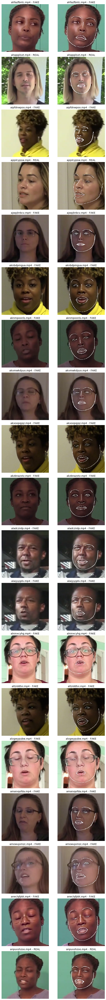

In [29]:
fig, axs = plt.subplots(19, 2, figsize=(10, 80))
axs = np.array(axs)
axs = axs.reshape(-1)
i = 0
pad = 60
for fn in train_sample_metadata.index[23:44]:
    label = train_sample_metadata.loc[fn]['label']
    orig = train_sample_metadata.loc[fn]['label']
    video_file = f'/kaggle/input/deepfake-detection-challenge/train_sample_videos/{fn}'
    ax = axs[i]
    cap = cv.VideoCapture(video_file)
    success, image = cap.read()
    image = cv.cvtColor(image, cv.COLOR_BGR2RGB)
    face_locations = face_recognition.face_locations(image)
    if len(face_locations) > 0:
        # Print first face
        face_location = face_locations[0]
        top, right, bottom, left = face_location
        face_image = image[top-pad:bottom+pad, left-pad:right+pad]
        ax.imshow(face_image)
        ax.grid(False)
        ax.title.set_text(f'{fn} - {label}')
        ax.xaxis.set_visible(False)
        ax.yaxis.set_visible(False)
        # Find landmarks
        face_landmarks_list = face_recognition.face_landmarks(face_image)
        try:
            face_landmarks = face_landmarks_list[0]
            pil_image = Image.fromarray(face_image)
            d = ImageDraw.Draw(pil_image)
            for facial_feature in face_landmarks.keys():
                d.line(face_landmarks[facial_feature], width=2, fill='white')
            landmark_face_array = np.array(pil_image)
            ax2 = axs[i+1]
            ax2.imshow(landmark_face_array)
            ax2.grid(False)
            ax2.title.set_text(f'{fn} - {label}')
            ax2.xaxis.set_visible(False)
            ax2.yaxis.set_visible(False)
            i += 2
        except:
            pass
plt.grid(False)
plt.tight_layout()
plt.show()



In [61]:
video_file = '../input/deepfake-detection-challenge/train_sample_videos/bjsmaqefoi.mp4'

cap = cv2.VideoCapture(video_file)

frames = []
while(cap.isOpened()):
    ret, frame = cap.read()
    if ret==True:
        frames.append(frame)
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
    else:
        break
cap.release()

print('The number of frames saved: ', len(frames))

The number of frames saved:  300


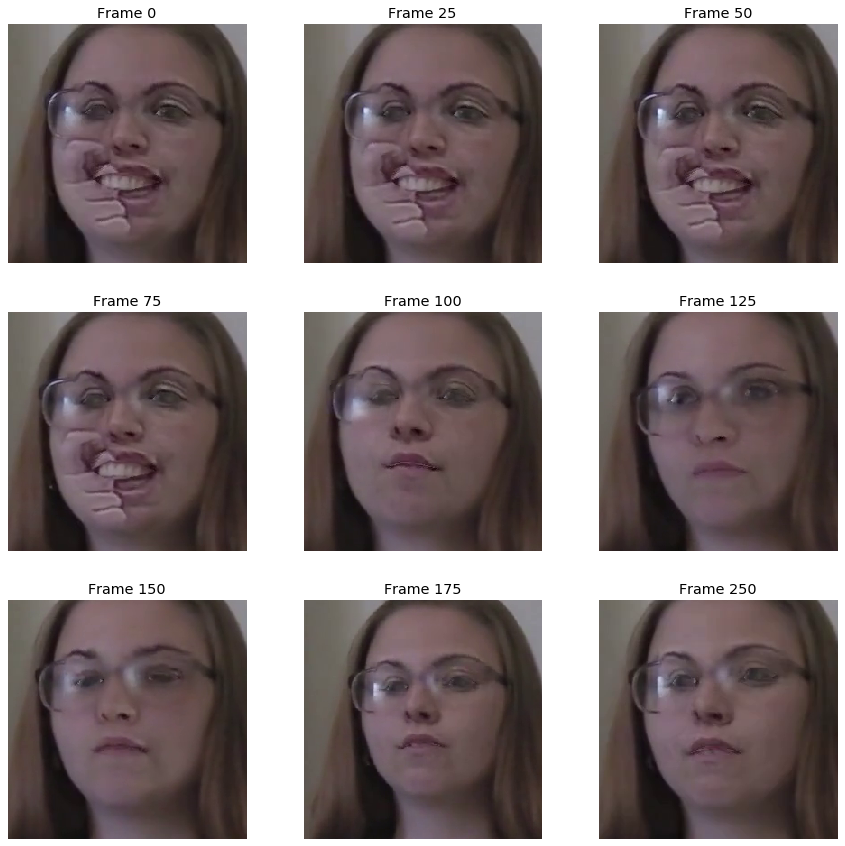

In [62]:
fig, axes = plt.subplots(3, 3, figsize=(15, 15))
axes = np.array(axes)
axes = axes.reshape(-1)
ax_ix = 0
padding = 40
for i in [0, 25, 50, 75, 100, 125, 150, 175, 250]:
    frame = frames[i]
    #fig, ax = plt.subplots(1,1, figsize=(5, 5))
    face_locations = face_recognition.face_locations(frame)
    if len(face_locations) == 0:
        print(f'Could not find face in frame {i}')
        continue
    top, right, bottom, left = face_locations[0]
    frame_face = frame[top-padding:bottom+padding, left-padding:right+padding]
    image = cv.cvtColor(frame_face, cv.COLOR_BGR2RGB)
    axes[ax_ix].imshow(image)
    axes[ax_ix].xaxis.set_visible(False)
    axes[ax_ix].yaxis.set_visible(False)
    axes[ax_ix].set_title(f'Frame {i}')
    ax_ix += 1
plt.grid(False)
plt.show()

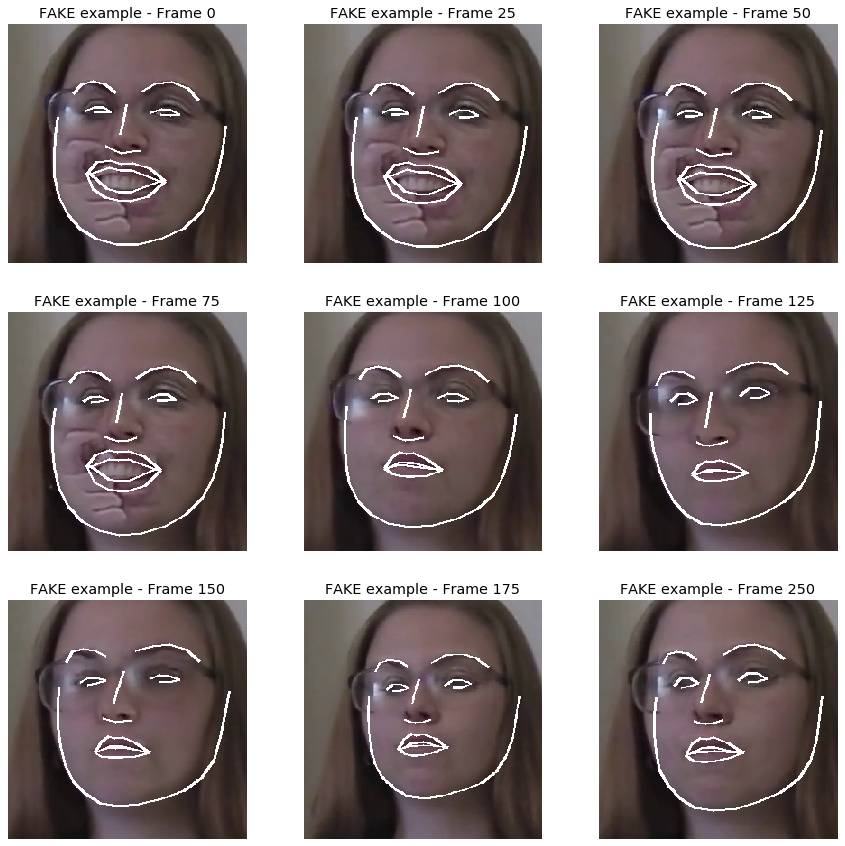

In [63]:
fig, axes = plt.subplots(3, 3, figsize=(15, 15))
axes = np.array(axes)
axes = axes.reshape(-1)
ax_ix = 0
padding = 40
for i in [0, 25, 50, 75, 100, 125, 150, 175, 250]:
    frame = frames[i]
    #fig, ax = plt.subplots(1,1, figsize=(5, 5))
    face_locations = face_recognition.face_locations(frame)
    if len(face_locations) == 0:
        print(f'Count find face in frame {i}')
        continue
    top, right, bottom, left = face_locations[0]
    frame_face = frame[top-padding:bottom+padding, left-padding:right+padding]
    face_landmarks_list = face_recognition.face_landmarks(frame_face)
    if len(face_landmarks_list) == 0:
        print(f'Could not identify face landmarks for frame {i}')
        continue
    face_landmarks = face_landmarks_list[0]
    pil_image = Image.fromarray(frame_face)
    d = ImageDraw.Draw(pil_image)
    for facial_feature in face_landmarks.keys():
        d.line(face_landmarks[facial_feature], width=3, fill='white')
    landmark_face_array = np.array(pil_image)
    image = cv.cvtColor(landmark_face_array, cv.COLOR_BGR2RGB)
    axes[ax_ix].imshow(image)
    axes[ax_ix].grid(False)
    axes[ax_ix].set_title(f'FAKE example - Frame {i}')
    axes[ax_ix].xaxis.set_visible(False)
    axes[ax_ix].yaxis.set_visible(False)
    ax_ix += 1
plt.grid(False)
plt.show()

The number of frames saved:  300


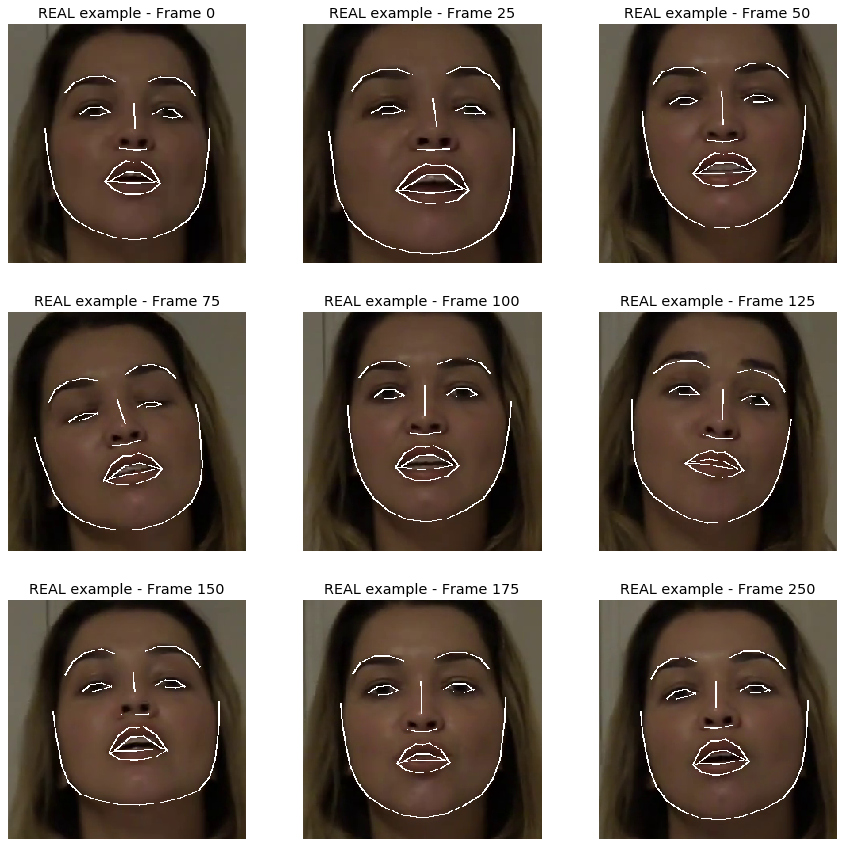

In [60]:
fn = 'ahqqqilsxt.mp4'
video_file = f'../input/deepfake-detection-challenge/train_sample_videos/bilnggbxgu.mp4'

cap = cv2.VideoCapture(video_file)

frames = []
while(cap.isOpened()):
    ret, frame = cap.read()
    if ret==True:
        frames.append(frame)
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
    else:
        break
cap.release()

print('The number of frames saved: ', len(frames))

fig, axes = plt.subplots(3, 3, figsize=(15, 15))
axes = np.array(axes)
axes = axes.reshape(-1)
ax_ix = 0
padding = 40
for i in [0, 25, 50, 75, 100, 125, 150, 175, 250]:
    frame = frames[i]
    #fig, ax = plt.subplots(1,1, figsize=(5, 5))
    face_locations = face_recognition.face_locations(frame)
    if len(face_locations) == 0:
        print(f'Count find face in frame {i}')
        continue
    top, right, bottom, left = face_locations[0]
    frame_face = frame[top-padding:bottom+padding, left-padding:right+padding]
    face_landmarks_list = face_recognition.face_landmarks(frame_face)
    if len(face_landmarks_list) == 0:
        print(f'Could not identify face landmarks for frame {i}')
        continue
    face_landmarks = face_landmarks_list[0]
    pil_image = Image.fromarray(frame_face)
    d = ImageDraw.Draw(pil_image)
    for facial_feature in face_landmarks.keys():
        d.line(face_landmarks[facial_feature], width=2, fill='white')
    landmark_face_array = np.array(pil_image)
    image = cv.cvtColor(landmark_face_array, cv.COLOR_BGR2RGB)
    axes[ax_ix].imshow(image)
    axes[ax_ix].grid(False)
    axes[ax_ix].set_title(f'REAL example - Frame {i}')
    axes[ax_ix].xaxis.set_visible(False)
    axes[ax_ix].yaxis.set_visible(False)
    ax_ix += 1
    if ax_ix >= len(axes):
        break
plt.grid(False)
plt.show()
